In [63]:
import numpy as np, pandas as pd, time, warnings, seaborn as sns, folium, matplotlib.pyplot as plt

# graph viz
import plotly.offline as pyo
from plotly.graph_objs import *
import plotly.graph_objs as go

#map section
import imageio
import folium.plugins as plugins

#settings
start_time=time.time()
color = sns.color_palette()
sns.set_style("dark")
warnings.filterwarnings("ignore")

In [64]:
business=pd.read_json("./Yelp_data/yelp_academic_dataset_business.json", lines = True)
# check_in=pd.read_json("./Yelp_data/yelp_academic_dataset_checkin.json", lines = True)

# tip=pd.read_json("./Yelp_data/yelp_academic_dataset_tip.json", lines = True)
# user=pd.read_json("./Yelp_data/yelp_academic_dataset_user.json", lines = True)

In [66]:
reviews=pd.read_json("./Yelp_data/yelp_academic_dataset_review.json", lines = True, nrows = 2000000)

In [68]:
from folium.plugins import HeatMap,MarkerCluster

m1=folium.Map(location = (37,-95),
              max_zoom=12,min_zoom=4,zoom_start=6,
              tiles='open street map')

locations = business.loc[business.is_open==1,['latitude','longitude']]
cluster = MarkerCluster(locations=locations,
                       ).add_to(m1)
    
m1

In [69]:
business['category'] = business['categories'].str.split(',')

In [70]:
business.head(10)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,category
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None,"[Doctors, Traditional Chinese Medicine, Natu..."
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ...","[Shipping Centers, Local Services, Notaries,..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ...","[Department Stores, Shopping, Fashion, Home..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ...","[Restaurants, Food, Bubble Tea, Coffee & Te..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2...","[Brewpubs, Breweries, Food]"
5,CF33F8-E6oudUQ46HnavjQ,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269593,-87.058943,2.0,6,1,"{'BusinessParking': 'None', 'BusinessAcceptsCr...","Burgers, Fast Food, Sandwiches, Food, Ice Crea...","{'Monday': '0:0-0:0', 'Tuesday': '6:0-22:0', '...","[Burgers, Fast Food, Sandwiches, Food, Ice..."
6,n_0UpQx1hsNbnPUSlodU8w,Famous Footwear,"8522 Eager Road, Dierbergs Brentwood Point",Brentwood,MO,63144,38.627695,-90.340465,2.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Sporting Goods, Fashion, Shoe Stores, Shopping...","{'Monday': '0:0-0:0', 'Tuesday': '10:0-18:0', ...","[Sporting Goods, Fashion, Shoe Stores, Shop..."
7,qkRM_2X51Yqxk3btlwAQIg,Temple Beth-El,400 Pasadena Ave S,St. Petersburg,FL,33707,27.766590,-82.732983,3.5,5,1,None,"Synagogues, Religious Organizations","{'Monday': '9:0-17:0', 'Tuesday': '9:0-17:0', ...","[Synagogues, Religious Organizations]"
8,k0hlBqXX-Bt0vf1op7Jr1w,Tsevi's Pub And Grill,8025 Mackenzie Rd,Affton,MO,63123,38.565165,-90.321087,3.0,19,0,"{'Caters': 'True', 'Alcohol': 'u'full_bar'', '...","Pubs, Restaurants, Italian, Bars, American (Tr...",None,"[Pubs, Restaurants, Italian, Bars, America..."
9,bBDDEgkFA1Otx9Lfe7BZUQ,Sonic Drive-In,2312 Dickerson Pike,Nashville,TN,37207,36.208102,-86.768170,1.5,10,1,"{'RestaurantsAttire': ''casual'', 'Restaurants...","Ice Cream & Frozen Yogurt, Fast Food, Burgers,...","{'Monday': '0:0-0:0', 'Tuesday': '6:0-21:0', '...","[Ice Cream & Frozen Yogurt, Fast Food, Burge..."


In [71]:
business_exploded = business.explode('category')

In [92]:
business[business['city'] == 'LasVegas'].head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,category


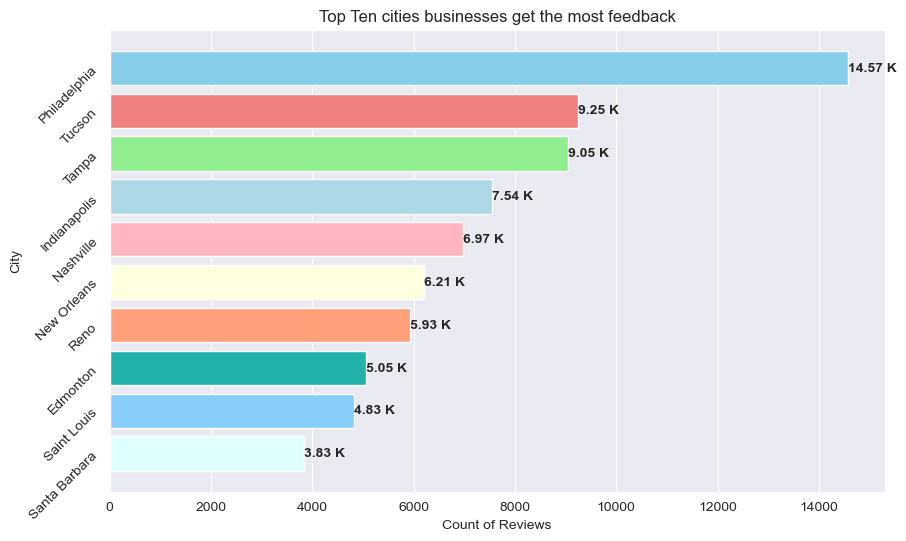

In [75]:
grouped = business.groupby('city').size().reset_index(name= 'Count')
grouped = grouped.sort_values(by='Count', ascending= False)
grouped = grouped.head(10)
plt.figure(figsize=(10,6))
custom_colors = ['skyblue', 'lightcoral', 'lightgreen', 'lightblue', 'lightpink',
                 'lightyellow', 'lightsalmon', 'lightseagreen', 'lightskyblue', 'lightcyan']
plt.barh(grouped['city'], grouped['Count'], color= custom_colors)
for i, count in enumerate(grouped['Count']):
    plt.text(count, i, f'{round(count/1000,2)} K', ha = 'left', va = 'center', size = 10, fontweight='bold')
plt.xlabel('Count of Reviews')
plt.ylabel('City')
plt.title('Top Ten cities businesses get the most feedback')
plt.grid(axis = 'x')
plt.yticks(rotation = 45)
plt.gca().invert_yaxis()
plt.show()

In [93]:
lasvegas = business[business['city'] == 'Saint Louis']
lasvegas = lasvegas.dropna()
longitude_center = lasvegas['longitude'].median()
latitude_center = lasvegas['latitude'].median()
m = folium.Map(location=[latitude_center, longitude_center], zoom_start=13)
for index, row in lasvegas.iterrows():
    folium.Circle(
        location=[row['latitude'], row['longitude']],
        radius=row['review_count']**0.5,  # Adjust the radius as needed
        fill=True,
        color='blue',
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(m)
m

In [99]:
business[business['state'] == 'NV']['city'].unique()

array(['Reno', 'Sparks', 'Fernley', 'Virginia City', 'Verdi',
       'Spanish Springs', 'Sun Valley', 'Reno ', 'SPARKS', 'RENO',
       'sparks', 'Washoe Valley', 'RENO AP', 'Reno Nevada', 'reno',
       'VC Highlands', 'Cold Springs', 'Nevada', 'Washoe', 'Sparks ',
       'Sparks NV', 'Mount Laurel', 'Carson City', 'McCarran',
       'New Washoe City', 'Reno City', 'Stead', 'South Reno', 'Sparks,',
       'Spark', 'Reno Sparks'], dtype=object)

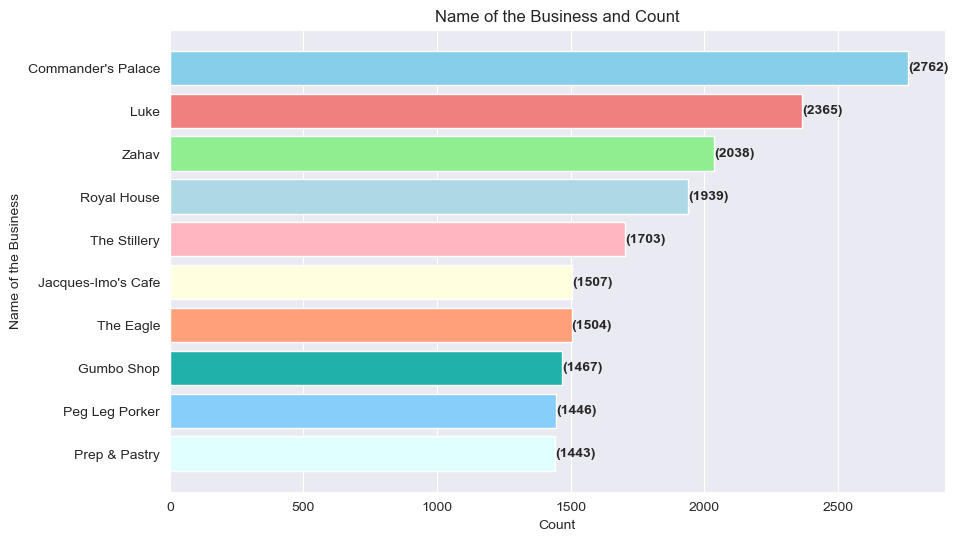

In [104]:
# Filter for reviews with 5 stars
five_star_reviews = reviews[reviews['stars'] == 5]

# Group by 'business_id' and count the number of 5-star reviews
business_counts = five_star_reviews['business_id'].value_counts().reset_index()
business_counts.columns = ['business_id', 'Count']

# Sort in descending order and take the top 10
most_5_stars_reviews = business_counts.sort_values(by='Count', ascending=False).head(10)

# # Merge with the 'business' DataFrame
most_5_stars_reviews = pd.merge(most_5_stars_reviews, business, on='business_id')

# # Create a bar plot
plt.figure(figsize=(10, 6))
custom_colors = ['skyblue', 'lightcoral', 'lightgreen', 'lightblue', 'lightpink',
                 'lightyellow', 'lightsalmon', 'lightseagreen', 'lightskyblue', 'lightcyan']
plt.barh(most_5_stars_reviews['name'], most_5_stars_reviews['Count'], color=custom_colors)
for i, count in enumerate(most_5_stars_reviews['Count']):
    plt.text(count, i, f"({count})", ha='left', va='center', size=10, fontweight='bold')
plt.xlabel('Count')
plt.ylabel('Name of the Business')
plt.title('Name of the Business and Count')
plt.gca().invert_yaxis()
plt.grid(axis='x')
plt.show()
